In [477]:
import pandas as pd
import numpy as np
import pathlib as Path

In [478]:
train = pd.read_csv('kaggle_data/train.csv')
test = pd.read_csv('kaggle_data/test.csv')

In [479]:
print(train.head())
print(train['label'].value_counts())
print(test.head())
print(" number of train pairs: ",len(train))
print(" number of test pairs: ",len(test))

   id  label
0   0      1
1   1      1
2   2      1
3   3      0
4   4      0
label
1    109
0     99
Name: count, dtype: int64
   id
0   0
1   1
2   2
3   3
4   4
 number of train pairs:  208
 number of test pairs:  208


In [480]:

df_A0 = pd.read_csv('kaggle_data/train/sample_0_a.csv',delim_whitespace=True,header=None)
df_B0 = pd.read_csv('kaggle_data/train/sample_0_b.csv',delim_whitespace=True,header=None)

In [514]:
df_A0.head(5)

,open,high,low,close,volume,position
0,265.11,265.67,263.72,265.67,154138.0,0.0
1,265.62,266.27,265.39,265.79,125246.0,0.0
2,265.91,266.07,265.21,265.68,85923.0,1.0
3,265.68,266.82,265.67,266.59,99735.0,1.0
4,266.51,266.74,264.15,264.80,547017.0,0.0


This is working with multivariate time-series data — that means for each agent we have several variables changing over time: Open, High, Low, Close, Volume (OHLCV)
Position: a binary column (1 = agent is holding a position / active trade, 0 = neutral)
For each pair of agents, the training label tells us which one performed better
label = 0 : Agent A wins
label = 1 : Agent B wins
So the prediction task is a pairwise preference problem — given two time-series (A and B), predict which agent’s behavior would be preferred or more profitable.

In [482]:
df_A0.columns = ['open','high','low','close','volume','position']
df_B0.columns = ['open','high','low','close','volume','position']

print("Shape of A", df_A0.shape)
print(df_A0.head())

print("Shape of B", df_B0.shape)
print(df_B0.head())

Shape of A (38, 6)
     open    high     low   close   volume  position
0  290.23  290.53  289.24  290.46  31528.0       0.0
1  290.38  290.73  289.97  290.38  30271.0       0.0
2  290.26  290.64  289.34  289.61  25305.0       0.0
3  289.69  290.08  289.49  289.78  22089.0       0.0
4  289.74  289.74  288.61  288.92  93933.0       0.0
Shape of B (38, 6)
     open    high     low   close   volume  position
0  290.23  290.53  289.24  290.46  31528.0       0.0
1  290.38  290.73  289.97  290.38  30271.0       0.0
2  290.26  290.64  289.34  289.61  25305.0       0.0
3  289.69  290.08  289.49  289.78  22089.0       0.0
4  289.74  289.74  288.61  288.92  93933.0       0.0


The first step is to load the provided datasets and understand their structure.
We have two main CSV files:
train.csv : contains the training pairs and their labels.
test.csv : contains the test pairs for which we must make predictions.
Each entry in the train and test data represents a pair of agents (A and B) who traded under similar market conditions.
For every id, there are two files inside the folders train/ and test/
Each of these CSVs contains six columns:
open, high, low, close, volume: describe market price movement over time (standard OHLCV data).
position: a binary column (1 means the agent is holding a trade, 0 means they are neutral).
Loaded the train.csv and test.csv files,printed their structure and counts to see how many training and testing pairs exist. Loaded the very first pair (sample_0_a and sample_0_b) to inspect how the time-series look.


Data expploration for one pair

To see how each agent behaved overtime, when each took position 1 and 0. Sicne dataset says position 1 when active--> expected to see different trading patterns between A and B

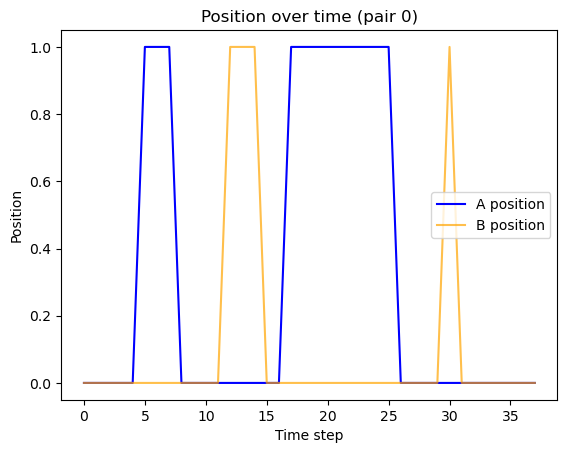

In [298]:
plt.plot(df_A0['position'], label='A position', color='blue')
plt.plot(df_B0['position'], label='B position', color='orange', alpha=0.7)
plt.title(f'Position over time (pair 0)')
plt.xlabel('Time step')
plt.ylabel('Position')
plt.legend()
plt.show()


Both lines show when each agent was active. A takes longer positions - stays 1 for several steps. B seems to trade little rarely. So they faced same market but different decisions.

Volume tells how much trading happened over time. High value means more active market. Plotting only 1 as both have same volume as they are in same market

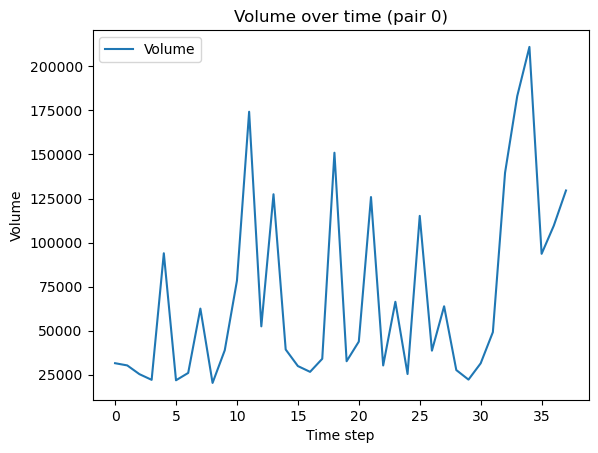

In [299]:
plt.plot(df_A0['volume'], label='Volume')
plt.title(f'Volume over time (pair 0)')
plt.xlabel('Time step')
plt.ylabel('Volume')
plt.legend()
plt.show()


There are several spikes and dips adn can use this later to see if agents prefer tradinf during high volume periods

Since btoh agents have same prices. now want to checj when an agent decides to trade compared to price movement. If teh agent is in position when price goes up - it gains, if it's active during a drop it might lose

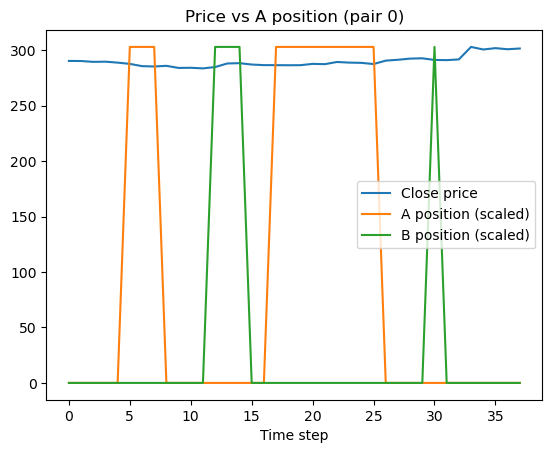

In [300]:
plt.plot(df_A0['close'], label='Close price')
plt.plot(df_A0['position'] * df_A0['close'].max(), label='A position (scaled)')
plt.plot(df_B0['position'] * df_B0['close'].max(), label='B position (scaled)')
plt.title(f'Price vs A position (pair 0)')
plt.xlabel('Time step')
plt.legend()
plt.show()


the blue line is the closing price.
The orange and green bars are when each agent is active 

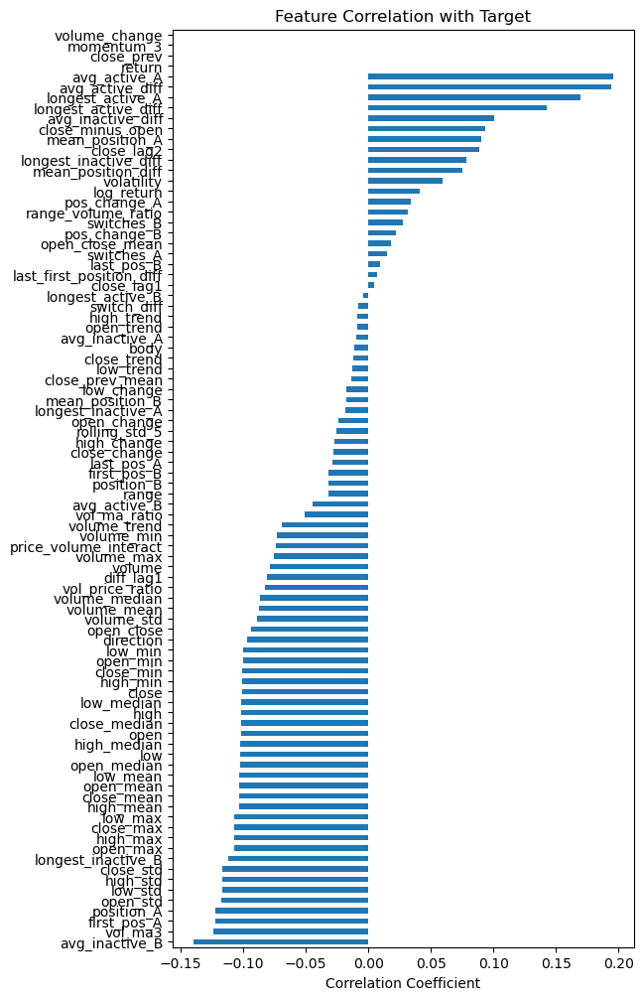

In [530]:
model_df.corr()
corrs = model_df.corr(numeric_only=True)['target'].sort_values(ascending=False)
plt.figure(figsize=(6,12))
corrs.drop('target', errors='ignore').sort_values().plot(kind='barh')
plt.title('Feature Correlation with Target')
plt.xlabel('Correlation Coefficient')
plt.show()

In [531]:
top_features = corrs.abs().sort_values(ascending=False).head(15)
print(top_features)

target                 1.000000
avg_active_A           0.195678
avg_active_diff        0.194004
longest_active_A       0.169727
longest_active_diff    0.143048
avg_inactive_B         0.139831
vol_ma3                0.123799
position_A             0.122273
first_pos_A            0.122273
open_std               0.117347
low_std                0.117097
high_std               0.116987
close_std              0.116750
longest_inactive_B     0.112214
open_max               0.107299
Name: target, dtype: float64


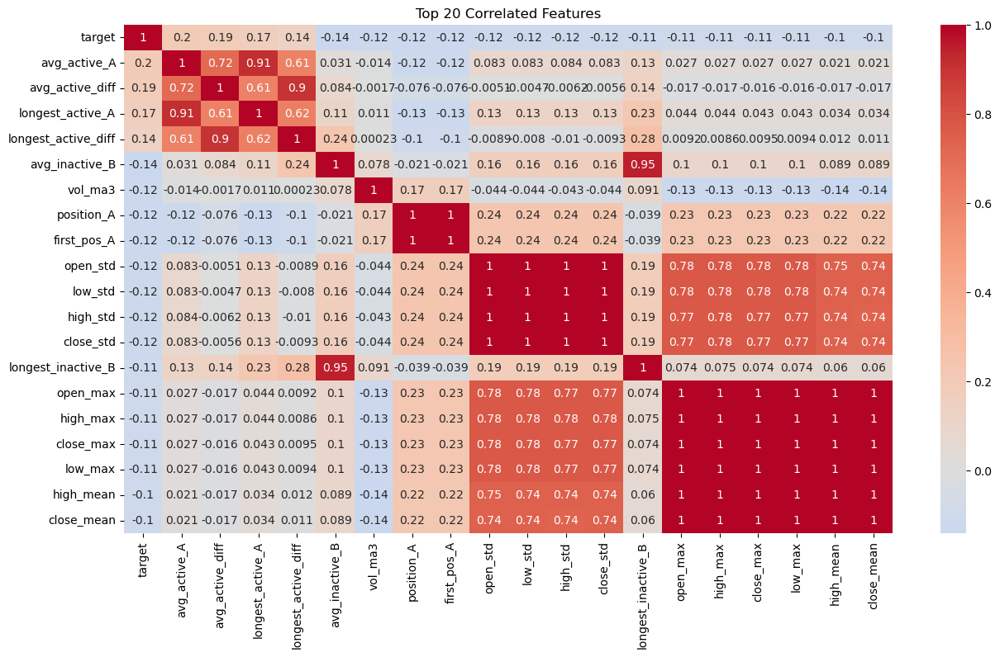

In [532]:
import seaborn as sns

top_corr_features = corrs.abs().sort_values(ascending=False).head(20).index
plt.figure(figsize=(15,8))
sns.heatmap(model_df[top_corr_features].corr(), annot=True, cmap='coolwarm', center=0)
plt.title('Top 20 Correlated Features')
plt.show()

Each agent (A and B) is a full time series: multiple time steps with columns like open, high, low, close, volume, and position.
But most ML models (Random Forest, XGBoost, MLP) expect one fixed-length feature vector per training example.
So my goal of this section is:Take two variable-length sequences (Agent A and Agent B) and compress them into a single feature row of numeric values describing that pair.
That’s what the function feature_generation(df_A0, df_B0) does.
We call it once per pair id, and it returns exactly one row for that pair.

Inside adding_derived_features, we create some basic per-timestep finance features:
return: percentage change in close price from one step to the next
range: how volatile that step was (high - low)
close_minus_open: intraperiod movement (did price go up or down between open and close?)
volume_change: how volume is changing over time. WHY? Raw price levels alone don’t tell us if something is “active” or “risky.”
Features like range and volume_change tell us if the market was jumpy or calm.

Derived market features:
Create return, range, close_minus_open, and volume_change — basic price & volume dynamics for each step.

Merge agents:
Combine position_A and position_B into one table so both agents’ actions are compared under the same market.

Position summaries:
Add stats like mean_position, first/last_pos, and pos_change to capture how active or consistent each agent was.

Switching behavior:
Count how often each agent changes position (switches_A/B) → captures trading frequency or reactivity.

Duration features:
Compute longest/average active & inactive streaks (longest_active_A/B, etc.) and their differences.

Descriptive stats:
For open, close, high, low, volume → compute mean, median, min, max, std, trend (slope), and change.
Also add open_close_mean and close_prev_mean.

Technical indicators:
Include body, direction, volatility, log_return, momentum_3, rolling_std_5, vol_ma3,
vol_ma_ratio, vol_price_ratio, price_volume_interact, range_volume_ratio, and lags.

Collapse to one row:
After computing all summaries, only the first row (iloc[0]) is kept since it contains pair-level features.
We loop through all 208 pairs, read each pair’s A & B CSVs, call feature_generation,
and concatenate results into model_df_train or model_df_test

In [ ]:
def feature_generation(df_A0,df_B0):

    def adding_derived_features(df):
        df = df.copy()

        df['return'] = df['close'].pct_change().replace([np.inf,-np.inf], np.nan).fillna(0)
        df['range'] =df['high'] - df['low']
        df['close_minus_open'] = df['close'] - df['open']
        df['volume_change'] = df['volume'].pct_change().replace([np.inf,-np.inf],np.nan).fillna(0)

        return df

    merged = df_A0[['open','high','low','close','volume','position']]
    merged = adding_derived_features(merged)
    merged.rename(columns={'position':'position_A'},inplace=True)
    merged['position_B'] = df_B0['position']

    df_A0 = adding_derived_features(df_A0)
    df_B0 = adding_derived_features(df_B0)

    merged['mean_position_A'] = merged['position_A'].mean()
    merged['mean_position_B'] = merged['position_B'].mean()
    merged['mean_position_diff'] = merged['mean_position_A']  - merged['mean_position_B']

    merged['first_pos_A'] = merged['position_A'].iloc[0]
    merged['last_pos_A']  = merged['position_A'].iloc[-1]

    merged['first_pos_B'] = merged['position_B'].iloc[0]
    merged['last_pos_B']  = merged['position_B'].iloc[-1]

    merged['pos_change_A'] = merged['last_pos_A']  - merged['first_pos_A']
    merged['pos_change_B'] = merged['last_pos_B'] - merged['first_pos_B']
    merged['last_first_position_diff'] = merged['pos_change_A'] - merged['pos_change_B']

    merged['switches_A'] = (merged['position_A'] != merged['position_A'].shift()).sum()
    merged['switches_B'] = (merged['position_B'] != merged['position_B'].shift()).sum()
    merged['switch_diff'] = merged['switches_A'] - merged['switches_B']



    def duration_features(position_series):
        # Convert to numpy array
        x = np.array(position_series)

        # Find streaks
        streaks = np.split(x, np.where(np.diff(x) != 0)[0] + 1)

        ones_streaks = [len(s) for s in streaks if s[0] == 1]
        zeros_streaks = [len(s) for s in streaks if s[0] == 0]

        return {
            'longest_active': max(ones_streaks) if ones_streaks else 0,
            'avg_active': np.mean(ones_streaks) if ones_streaks else 0,
            'longest_inactive': max(zeros_streaks) if zeros_streaks else 0,
            'avg_inactive': np.mean(zeros_streaks) if zeros_streaks else 0,
        }
    A_feats = duration_features(merged['position_A'])
    B_feats = duration_features(merged['position_B'])

    duration_diff = {f"{k}_diff": A_feats[k] - B_feats[k] for k in A_feats}

    rename_map_A = {'longest_active': 'longest_active_A', 'avg_active': 'avg_active_A','longest_inactive':'longest_inactive_A','avg_inactive':'avg_inactive_A'}

    A_feats = {rename_map_A.get(k, k): v for k, v in A_feats.items()}

    rename_map_B = {'longest_active': 'longest_active_B', 'avg_active': 'avg_active_B','longest_inactive':'longest_inactive_B','avg_inactive':'avg_inactive_B'}

    B_feats = {rename_map_B.get(k, k): v for k, v in B_feats.items()}

    combined = {**A_feats, **B_feats, **duration_diff}

    for key, value in combined.items():
        merged[key] = value

    from scipy.stats import linregress

    def descriptive_stats(df):
        summary = {}
        for col in ['open','close','high','low','volume']:
            summary[f'{col}_mean'] = df[col].mean()
            summary[f'{col}_median'] = df[col].median()
            summary[f'{col}_min'] = df[col].min()
            summary[f'{col}_max'] = df[col].max()
            summary[f'{col}_std'] = df[col].std()
            # Trend
            summary[f'{col}_trend'] = linregress(range(len(df)), df[col]).slope
            # First-last diff
            summary[f'{col}_change'] = df[col].iloc[-1] - df[col].iloc[0]


        # Derived columns
        df['open_close'] = df['open'] - df['close']
        summary['open_close_mean'] = df['open_close'].mean()
        df['close_prev'] = df['close'].diff()
        summary['close_prev_mean'] = df['close_prev'].mean()

        return summary

    # Agent A and B summaries
    merged_summary = descriptive_stats(merged)


    for key, value in merged_summary.items():
            merged[key] = value


    merged["body"] = (merged["close"] - merged["open"]).abs()
    merged["direction"] = np.sign(merged["close"] - merged["open"])
    merged["volatility"] = merged["range"] / merged["open"]
    merged["log_return"] = np.log(merged["close"] / merged["open"])
    merged["momentum_3"] = merged["close"] - merged["close"].shift(3)
    merged["rolling_std_5"] = merged["close"].rolling(5).std()
    merged["volume_change"] = merged["volume"].pct_change()
    merged["vol_ma3"] = merged["volume"].rolling(3).mean()
    merged["vol_ma_ratio"] = merged["volume"] / (merged["vol_ma3"] + 1e-9)
    merged["vol_price_ratio"] = merged["volume"] / (merged["close"] - merged["open"]).abs().replace(0, np.nan)
    merged["price_volume_interact"] = merged["close"] * merged["volume"]
    merged["range_volume_ratio"] = merged["range"] / (merged["volume"] + 1e-9)
    merged["close_lag1"] = merged["close"].shift(1)
    merged["close_lag2"] = merged["close"].shift(2)
    merged["diff_lag1"] = merged["close"] - merged["close_lag1"]

    merge_0 = merged.iloc[[0]]

    return merge_0

In [520]:
cols = ['open','high','low','close','volume','position_A', 'return', 'close_minus_open', 'position_B',
       'mean_position_A', 'mean_position_B', 'mean_position_diff',
       'first_pos_A', 'last_pos_A', 'first_pos_B', 'last_pos_B',
       'pos_change_A', 'pos_change_B', 'last_first_position_diff',
       'switches_A', 'switches_B', 'switch_diff', 'longest_active_A',
       'avg_active_A', 'longest_inactive_A', 'avg_inactive_A',
       'longest_active_B', 'avg_active_B', 'longest_inactive_B',
       'avg_inactive_B', 'longest_active_diff', 'avg_active_diff',
       'longest_inactive_diff', 'avg_inactive_diff', 'open_close',
       'close_prev', 'open_mean', 'open_median', 'open_min', 'open_max',
       'open_std', 'open_trend', 'open_change', 'close_mean', 'close_median',
       'close_min', 'close_max', 'close_std', 'close_trend', 'close_change',
       'high_mean', 'high_median', 'high_min', 'high_max', 'high_std',
       'high_trend', 'high_change', 'low_mean', 'low_median', 'low_min',
       'low_max', 'low_std', 'low_trend', 'low_change', 'open_close_mean',
       'close_prev_mean', 'volume_mean', 'volume_median', 'volume_min',
       'volume_max', 'volume_std', 'volume_trend','range','body', 'direction','volatility',
       'log_return', 'momentum_3','rolling_std_5','volume_change','vol_ma3','vol_ma_ratio',
        'vol_price_ratio', 'price_volume_interact', 'range_volume_ratio','close_lag1', 'close_lag2','diff_lag1']

model_df = pd.DataFrame(columns=cols)

for i in range(0,208):

    df_A0 = pd.read_csv(f'kaggle_data/train/sample_{i}_a.csv',
                       delim_whitespace=True, header=None)

    df_B0 = pd.read_csv(f'kaggle_data/train/sample_{i}_b.csv',
                       delim_whitespace=True, header=None)
    df_A0.columns = ['open','high','low','close','volume','position']
    df_B0.columns = ['open','high','low','close','volume','position']


    merge_0 = feature_generation(df_A0,df_B0)


    model_df = pd.concat([model_df, merge_0], ignore_index=True)


In [521]:
cols = ['open','high','low','close','volume','position_A', 'return', 'close_minus_open', 'position_B',
       'mean_position_A', 'mean_position_B', 'mean_position_diff',
       'first_pos_A', 'last_pos_A', 'first_pos_B', 'last_pos_B',
       'pos_change_A', 'pos_change_B', 'last_first_position_diff',
       'switches_A', 'switches_B', 'switch_diff', 'longest_active_A',
       'avg_active_A', 'longest_inactive_A', 'avg_inactive_A',
       'longest_active_B', 'avg_active_B', 'longest_inactive_B',
       'avg_inactive_B', 'longest_active_diff', 'avg_active_diff',
       'longest_inactive_diff', 'avg_inactive_diff', 'open_close',
       'close_prev', 'open_mean', 'open_median', 'open_min', 'open_max',
       'open_std', 'open_trend', 'open_change', 'close_mean', 'close_median',
       'close_min', 'close_max', 'close_std', 'close_trend', 'close_change',
       'high_mean', 'high_median', 'high_min', 'high_max', 'high_std',
       'high_trend', 'high_change', 'low_mean', 'low_median', 'low_min',
       'low_max', 'low_std', 'low_trend', 'low_change', 'open_close_mean',
       'close_prev_mean', 'volume_mean', 'volume_median', 'volume_min',
       'volume_max', 'volume_std', 'volume_trend','range','body', 'direction','volatility',
       'log_return', 'momentum_3','rolling_std_5','volume_change','vol_ma3','vol_ma_ratio',
        'vol_price_ratio', 'price_volume_interact', 'range_volume_ratio','close_lag1', 'close_lag2','diff_lag1']

model_df_test = pd.DataFrame(columns=cols)

for i in range(0,208):

    df_A0_test = pd.read_csv(f'kaggle_data/test/sample_{i}_a.csv',
                       delim_whitespace=True, header=None)

    df_B0_test = pd.read_csv(f'kaggle_data/test/sample_{i}_b.csv',
                       delim_whitespace=True, header=None)
    df_A0_test.columns = ['open','high','low','close','volume','position']
    df_B0_test.columns = ['open','high','low','close','volume','position']


    merge_0_test = feature_generation(df_A0_test,df_B0_test)


    model_df_test = pd.concat([model_df_test, merge_0_test], ignore_index=True)


This cell and below cell does for training and testing ;creates rolling, ratio, and lag-based features to help the model understand short-term market trends and momentum that simple static stats can’t capture.

It uses rolling windows (rolling_std_5, vol_ma3) to measure recent volatility and smooth volume changes.

Then adds derived ratios & interactions (vol_ma_ratio, vol_price_ratio, price_volume_interact, range_volume_ratio) to link price movement and trading activity.

Lag features (close_lag1, close_lag2, diff_lag1) let the model see past price behaviour — capturing momentum and direction.

Finally, it fills NaNs from rolling/lag operations to keep the dataset model-ready.

In [522]:
feature_info = {
    'rolling_std_5': 5,
    'vol_ma3': 3,
    'vol_ma_ratio': 2,
    'vol_price_ratio': 4,
    'price_volume_interact': 0,
    'range_volume_ratio': 0,
    'close_lag1': 1,
    'close_lag2': 2,
    'diff_lag1': 1
}
model_df['rolling_std_5'] = model_df['close'].rolling(window=feature_info['rolling_std_5']).std()
model_df['vol_ma3'] = model_df['volume'].rolling(window=feature_info['vol_ma3']).mean()

# Derived ones
model_df['vol_ma_ratio'] = model_df['volume'] / model_df['vol_ma3']
model_df['vol_price_ratio'] = model_df['volume'] / model_df['close']
model_df['price_volume_interact'] = model_df['close'] * model_df['volume']
model_df['range_volume_ratio'] = (model_df['high'] - model_df['low']) / (model_df['volume'] + 1e-6)

# Lag features
model_df['close_lag1'] = model_df['close'].shift(feature_info['close_lag1'])
model_df['close_lag2'] = model_df['close'].shift(feature_info['close_lag2'])
model_df['diff_lag1'] = model_df['close'].diff(periods=feature_info['diff_lag1'])

# Fill NaNs from rolling/lag ops
model_df = model_df.fillna(0)

In [524]:
feature_info = {
    'rolling_std_5': 5,
    'vol_ma3': 3,
    'vol_ma_ratio': 2,
    'vol_price_ratio': 4,
    'price_volume_interact': 0,
    'range_volume_ratio': 0,
    'close_lag1': 1,
    'close_lag2': 2,
    'diff_lag1': 1
}
model_df_test['rolling_std_5'] = model_df_test['close'].rolling(window=feature_info['rolling_std_5']).std()
model_df_test['vol_ma3'] = model_df_test['volume'].rolling(window=feature_info['vol_ma3']).mean()

# Derived ones
model_df_test['vol_ma_ratio'] = model_df_test['volume'] / model_df_test['vol_ma3']
model_df_test['vol_price_ratio'] = model_df_test['volume'] / model_df_test['close']
model_df_test['price_volume_interact'] = model_df_test['close'] * model_df_test['volume']
model_df_test['range_volume_ratio'] = (model_df_test['high'] - model_df_test['low']) / (model_df_test['volume'] + 1e-6)

# Lag features
model_df_test['close_lag1'] = model_df_test['close'].shift(feature_info['close_lag1'])
model_df_test['close_lag2'] = model_df_test['close'].shift(feature_info['close_lag2'])
model_df_test['diff_lag1'] = model_df_test['close'].diff(periods=feature_info['diff_lag1'])

# Fill NaNs from rolling/lag ops
model_df_test = model_df_test.fillna(0)

In [525]:
target = pd.read_csv('kaggle_data/train.csv')
model_df['target'] = target['label']

In [526]:
target = pd.read_csv('kaggle_data/test.csv')
model_df_test['id'] = target['id']

After testing multiple models (Random Forest, XGBoost, LSTM, etc.) and tuning parameters, I identified which features contributed most to performance.

To streamline further experiments, I created 4 curated feature sets (top_features1–top_features4) — each representing slightly different perspectives

Instead of re-running full feature generation each time, I can now directly test models using these below feature sets to compare accuracy and find the most effective combination for the final submission.

In [ ]:
top_features1 = [
    'avg_active_A',
    'avg_active_diff',
    'avg_inactive_B',
    'position_A',
    'first_pos_A',
    'open_std',
    'low_std',
    'high_std',
    'close_std',
    'open_max',
    'high_max',
    'close_max',
    'low_max',
    'high_mean'
]

In [541]:
top_features = ['return',
 'close_minus_open',
 'volume_change',
 'mean_position_B',
 'first_pos_A',
 'last_pos_B',
 'longest_active_A',
 'longest_inactive_diff',
 'open_min',
 'open_max',
 'close_max',
 'high_max',
 'volume_mean',
 'volume_std',
 'volume_trend',
 'longest_active_B',
 'last_pos_A',
 'first_pos_B']

In [ ]:
top_features2 = ['return',
     'first_pos_A', 'first_pos_B', 'last_pos_B', 'pos_change_A',
     'pos_change_B', 'last_first_position_diff', 'longest_active_A',
     'longest_inactive_B', 'avg_inactive_B', 'longest_active_diff',
     'longest_inactive_diff','body',
       'direction', 'volatility', 'log_return', 'momentum_3', 'rolling_std_5',
       'volume_change', 'vol_ma3', 'vol_ma_ratio', 'vol_price_ratio',
       'price_volume_interact', 'range_volume_ratio', 'close_lag1',
       'close_lag2', 'diff_lag1','range']

In [494]:
top_features3 =['position_A', 'return', 'range', 'close_minus_open', 'volume_change',
       'position_B', 'mean_position_A', 'mean_position_B',
       'mean_position_diff', 'first_pos_A', 'last_pos_A', 'first_pos_B',
       'last_pos_B', 'pos_change_A', 'pos_change_B',
       'last_first_position_diff', 'switches_A', 'switches_B', 'switch_diff',
       'longest_active_A', 'avg_active_A', 'longest_inactive_A',
       'avg_inactive_A', 'longest_active_B', 'avg_active_B',
       'longest_inactive_B', 'avg_inactive_B', 'longest_active_diff',
       'avg_active_diff', 'longest_inactive_diff', 'avg_inactive_diff',
       'target', 'body', 'direction', 'volatility', 'log_return', 'momentum_3',
       'rolling_std_5', 'vol_ma3', 'vol_ma_ratio', 'vol_price_ratio',
       'price_volume_interact', 'range_volume_ratio', 'close_lag1',
       'close_lag2', 'diff_lag1']

In [ ]:
top_features4 = ['pos_change_A', 'pos_change_B', 'longest_active_diff', 'longest_inactive_diff',
'body', 'volatility', 'log_return', 'momentum_3',
'vol_ma_ratio', 'price_volume_interact', 'range_volume_ratio',
'diff_lag1','return']

In [542]:
X = model_df[top_features]
y = model_df['target']

X_test = model_df_test[top_features]
test_ids = model_df_test['id'].astype(int)

In [341]:
from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from xgboost import XGBClassifier


In this step, I used a Random Forest Classifier and applied GridSearchCV to find the best combination of hyperparameters for classification accuracy. Random Forest is an ensemble of decision trees that helps reduce overfitting and improves generalization. The parameter grid explores different settings:
n_estimators: number of trees in the forest
max_depth: maximum tree depth (controls complexity)
min_samples_split & min_samples_leaf: control node splitting
max_features: how many features are considered at each split
Used 5-fold Stratified Cross Validation to ensure balanced label distribution across folds.Finally, printed the best parameters and best cross-validation accuracy to evaluate model performance.

In [544]:
rf_model = RandomForestClassifier(random_state=42)

rf_param_grid = {
    'n_estimators': [200, 400, 800],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

rf_search = GridSearchCV(
    estimator=rf_model,
    param_grid=rf_param_grid,
    scoring='accuracy',
    n_jobs=1,
    cv=cv,
    verbose=1
)

rf_search.fit(X, y)

print("Best RF params:", rf_search.best_params_)
print("Best RF CV accuracy:", rf_search.best_score_)


Fitting 5 folds for each of 216 candidates, totalling 1080 fits


KeyboardInterrupt: 

After running above model got :{'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 200} as best parameters for top_features

In [343]:
rf_search.best_estimator_

RandomForestClassifier(min_samples_split=10, n_estimators=200, random_state=42)

After testing Random Forest, I moved to XGBoost because it’s a more advanced ensemble technique that often achieves better performance on structured data like this competition.
Why? It builds trees sequentially, where each tree learns from the errors of the previous ones (boosting), unlike Random Forest which trains trees independently (bagging).
includes regularization (L1 & L2) and learning rate control, helping prevent overfitting, handles nonlinear interactions and complex feature relationships more effectively.
The following block performs hyperparameter tuning using GridSearchCV, just like we did for Random Forest — but this time focusing on parameters that control boosting behavior (learning_rate, subsample, max_depth, etc.).

In [344]:
xgb_model = XGBClassifier(
    objective='binary:logistic',
    eval_metric='logloss',
    random_state=42,
    use_label_encoder=False
)

xgb_param_grid = {
    'n_estimators': [200, 400, 800],
    'max_depth': [3, 4, 6],
    'learning_rate': [0.05, 0.1, 0.2],
    'subsample': [0.7, 1.0],
    'colsample_bytree': [0.7, 1.0],
    'min_child_weight': [1, 3, 5],
}

cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

xgb_search = GridSearchCV(
    estimator=xgb_model,
    param_grid=xgb_param_grid,
    scoring='accuracy',
    n_jobs=-1,
    cv=cv,
    verbose=1
)

xgb_search.fit(X, y)

print("Best XGB params:", xgb_search.best_params_)
print("Best XGB CV accuracy:", xgb_search.best_score_)


Fitting 5 folds for each of 324 candidates, totalling 1620 fits


/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [00:51:39] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [00:51:39] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [00:51:39] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [00:51:39] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:7

Best XGB params: {'colsample_bytree': 0.7, 'learning_rate': 0.2, 'max_depth': 6, 'min_child_weight': 5, 'n_estimators': 800, 'subsample': 1.0}
Best XGB CV accuracy: 0.6156794425087108


In [345]:
xgb_search.best_estimator_

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.7, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, feature_weights=None, gamma=None,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=5, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=800, n_jobs=None,
              num_parallel_tree=None, ...)

In [346]:
rf_best = rf_search.best_estimator_

rf_test_preds = rf_best.predict(X_test).astype(int)

rf_submission = pd.DataFrame({
    'id': test_ids,
    'label': rf_test_preds
})

print("Random Forest submission preview:")
print(rf_submission.head())

#rf_submission.to_csv('submission_rf.csv', index=False)


Random Forest submission preview:
   id  label
0   0      0
1   1      0
2   2      1
3   3      0
4   4      1


In [349]:
xgb_best = xgb_search.best_estimator_

xgb_test_preds = xgb_best.predict(X_test).astype(int)

xgb_submission = pd.DataFrame({
    'id': test_ids,
    'label': xgb_test_preds
})

print("XGBoost submission preview:")
print(xgb_submission.head())

#xgb_submission.to_csv('submission_xgb.csv', index=False)


XGBoost submission preview:
   id  label
0   0      0
1   1      1
2   2      1
3   3      0
4   4      1


In [347]:
rf_importance = pd.Series(
    rf_best.feature_importances_,
    index=top_features
).sort_values(ascending=False)

print("RF feature importance:\n", rf_importance)


RF feature importance:
 avg_inactive_B     0.111195
avg_active_A       0.106417
avg_active_diff    0.092869
low_max            0.085133
close_max          0.082498
high_max           0.080521
open_max           0.080476
high_mean          0.074398
close_std          0.070592
open_std           0.068621
low_std            0.067178
high_std           0.066686
first_pos_A        0.008731
position_A         0.004686
dtype: float64


In [350]:
xgb_importance = pd.Series(
    xgb_best.feature_importances_,
    index=top_features
).sort_values(ascending=False)

print("XGB feature importance:\n", xgb_importance)


XGB feature importance:
 low_max            0.142671
close_max          0.103412
open_max           0.097802
avg_active_A       0.090525
close_std          0.086156
low_std            0.084324
avg_inactive_B     0.072358
open_std           0.070727
high_std           0.069243
high_max           0.068178
avg_active_diff    0.062050
high_mean          0.052556
position_A         0.000000
first_pos_A        0.000000
dtype: float32


After trying tree-based models (RF, XGBoost) that treat data as independent samples, I moved to a Neural Network — specifically an LSTM (Long Short-Term Memory) — to capture temporal patterns within each agent pair’s sequence.
The dataset represents time-series behavior (e.g., open, close, volume over time). LSTMs are designed to learn dependencies over time, which traditional models like RF or XGBoost cannot capture.
This can help detect sequential trends or reactions between Agent A and Agent B.

In [351]:
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [353]:
# pad_sequences will add zeros at the end so all have same length
X_padded = pad_sequences(X, padding='post', dtype='float32')
y = np.array(y)

print(X_padded.shape)  # (n_samples, max_timesteps, n_features)


(208, 254, 12)


LSTM is the best model given the submission on Kaggle with 59%. Also LSTM is good for such project objectives. Given that the data had only 208 pairs if there were more pairs, it would've trained the model better.


In [361]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Masking

timesteps = X_padded.shape[1]
n_features = X_padded.shape[2]

# model = Sequential([
#     Masking(mask_value=0.0, input_shape=(timesteps, n_features)),  # ignore padded zeros
#     LSTM(64, return_sequences=False),
#     Dropout(0.3),
#     Dense(32, activation='relu'),
#     Dropout(0.3),
#     Dense(1, activation='sigmoid')  # output: probability that B wins
# ])
model = Sequential([
    Masking(mask_value=0.0, input_shape=(timesteps, n_features)),
    LSTM(32),
    Dense(1, activation='sigmoid')
])
model.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy']
)

model.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 masking_1 (Masking)         (None, 254, 12)           0         
                                                                 
 lstm_1 (LSTM)               (None, 32)                5760      
                                                                 
 dense_2 (Dense)             (None, 1)                 33        
                                                                 
Total params: 5793 (22.63 KB)
Trainable params: 5793 (22.63 KB)
Non-trainable params: 0 (0.00 Byte)
_________________________________________________________________


In [362]:
from tensorflow.keras.callbacks import EarlyStopping

early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = model.fit(
    X_padded, y,
    validation_split=0.2,
    epochs=50,
    batch_size=16,
    callbacks=[early_stop],
    verbose=1
)


Epoch 1/50
11/11 [==============================] - 2s 87ms/step - loss: 0.7595 - accuracy: 0.5000 - val_loss: 0.8244 - val_accuracy: 0.3810
Epoch 2/50
11/11 [==============================] - 0s 39ms/step - loss: 0.7438 - accuracy: 0.5000 - val_loss: 0.8036 - val_accuracy: 0.3810
Epoch 3/50
11/11 [==============================] - 0s 38ms/step - loss: 0.7306 - accuracy: 0.5000 - val_loss: 0.7858 - val_accuracy: 0.3810
Epoch 4/50
11/11 [==============================] - 0s 39ms/step - loss: 0.7216 - accuracy: 0.5000 - val_loss: 0.7680 - val_accuracy: 0.3810
Epoch 5/50
11/11 [==============================] - 0s 37ms/step - loss: 0.7131 - accuracy: 0.5000 - val_loss: 0.7535 - val_accuracy: 0.3810
Epoch 6/50
11/11 [==============================] - 0s 37ms/step - loss: 0.7080 - accuracy: 0.5000 - val_loss: 0.7395 - val_accuracy: 0.3810
Epoch 7/50
11/11 [==============================] - 0s 37ms/step - loss: 0.7033 - accuracy: 0.5000 - val_loss: 0.7301 - val_accuracy: 0.3810
Epoch 8/50
11

In [356]:
test_ids = pd.read_csv('kaggle_data/test.csv')
X_test = []

for i in test_ids['id']:
    df_A = pd.read_csv(f'kaggle_data/test/sample_{i}_a.csv',
                       delim_whitespace=True, header=None)
    df_B = pd.read_csv(f'kaggle_data/test/sample_{i}_b.csv',
                       delim_whitespace=True, header=None)

    df_A.columns = ['open','high','low','close','volume','position']
    df_B.columns = ['open','high','low','close','volume','position']

    combined = pd.concat([df_A, df_B.add_suffix('_B')], axis=1)
    X_test.append(combined.values)

X_test_padded = pad_sequences(X_test, maxlen=X_padded.shape[1], padding='post', dtype='float32')


In [357]:
test_probs = model.predict(X_test_padded)
test_preds = (test_probs > 0.5).astype(int).ravel()

submission = pd.DataFrame({
    'id': test_ids['id'],
    'label': test_preds
})

#submission.to_csv('submission_lstm.csv', index=False)
print(submission.head())


7/7 [==============================] - 1s 14ms/step
   id  label
0   0      1
1   1      1
2   2      1
3   3      1
4   4      1


In [398]:
from xgboost import XGBClassifier
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.model_selection import StratifiedKFold

# Define model
xgb = XGBClassifier(
    colsample_bytree= 0.7, learning_rate= 0.2, max_depth= 6, min_child_weight=5, n_estimators=800, subsample=1.0
)

# Define cross-validation
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# Sequential forward selection
sfs = SequentialFeatureSelector(
    estimator=xgb,
    n_features_to_select="auto",  # or manually: 8 or 10
    direction="forward",          # can be 'backward' too
    scoring="accuracy",
    cv=cv,
    n_jobs=-1
)

# Fit to your data
sfs.fit(X, y)

# Get selected features
selected_features = X.columns[sfs.get_support()]
print("Selected features:", list(selected_features))

/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:700: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Selected features: ['return', 'close_minus_open', 'volume_change', 'mean_position_A', 'mean_position_B', 'first_pos_A', 'first_pos_B', 'last_pos_B', 'pos_change_A', 'pos_change_B', 'last_first_position_diff', 'longest_active_A', 'longest_inactive_B', 'avg_inactive_B', 'longest_active_diff', 'longest_inactive_diff', 'open_close', 'open_mean', 'open_median', 'open_min', 'open_max', 'close_min', 'close_max', 'high_median', 'high_min', 'high_max', 'low_mean', 'low_median', 'low_min', 'low_max', 'volume_mean', 'volume_std', 'volume_trend']


In [397]:
from sklearn.feature_selection import SequentialFeatureSelector
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold

model = RandomForestClassifier(random_state=42,min_samples_leaf=1,min_samples_split=10,n_estimators=200)
cv = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

sfs = SequentialFeatureSelector(model, direction='forward', cv=cv, scoring='accuracy')
sfs.fit(X, y)
print(X.columns[sfs.get_support()])

Index(['return', 'range', 'close_minus_open', 'volume_change',
       'mean_position_B', 'mean_position_diff', 'first_pos_A', 'last_pos_B',
       'switches_A', 'switches_B', 'switch_diff', 'longest_active_A',
       'longest_inactive_A', 'avg_inactive_A', 'longest_active_B',
       'avg_active_diff', 'longest_inactive_diff', 'open_min', 'open_max',
       'open_std', 'open_trend', 'close_max', 'close_std', 'high_max',
       'high_std', 'high_change', 'low_std', 'low_change', 'volume_mean',
       'volume_median', 'volume_min', 'volume_std', 'volume_trend'],
      dtype='object')


In [401]:
top_features2 = ['return',
 'close_minus_open',
 'volume_change',
 'mean_position_B',
 'first_pos_A',
 'last_pos_B',
 'longest_active_A',
 'longest_inactive_diff',
 'open_min',
 'open_max',
 'close_max',
 'high_max',
 'volume_mean',
 'volume_std',
 'volume_trend',
 'longest_active_B',
 'last_pos_A',
 'first_pos_B']

In [404]:
X3 = model_df[top_features2]
X3

,return,close_minus_open,volume_change,mean_position_B,first_pos_A,last_pos_B,longest_active_A,longest_inactive_diff,open_min,open_max,close_max,high_max,volume_mean,volume_std,volume_trend,longest_active_B,last_pos_A,first_pos_B
0,0.0,0.23,98031.0,0.105263,0.0,0.0,9,-3,282.44,303.09,303.09,305.49,6.907874e+04,5.289519e+04,1973.614838,3,0.0,0.0
1,0.0,0.12,616111.0,0.347032,0.0,1.0,25,-10,53.04,72.08,72.07,72.35,5.414447e+05,3.992646e+05,1771.389968,11,1.0,0.0
2,0.0,-0.23,772003.0,0.403670,0.0,0.0,63,13,54.68,59.01,59.19,59.38,1.507819e+06,1.101395e+06,6984.685970,30,0.0,0.0
3,0.0,0.52,433369.0,0.000000,0.0,0.0,39,-125,156.86,193.90,193.95,194.29,5.870220e+05,5.670081e+05,417.658912,0,0.0,0.0
4,0.0,-0.90,-538000.0,0.596154,0.0,1.0,13,13,137.55,155.51,155.68,156.32,6.857400e+05,4.089207e+05,1088.686972,31,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,0.0,-0.51,-31065.0,0.882353,0.0,1.0,3,8,243.56,248.15,248.08,248.34,4.811000e+04,2.945182e+04,-1676.191176,15,0.0,0.0
204,0.0,-8.13,-947845.0,0.860759,0.0,0.0,10,22,241.13,314.00,305.87,317.59,2.932910e+05,2.630099e+05,-5502.057717,68,0.0,0.0
205,0.0,0.04,48790.0,0.318386,0.0,0.0,42,-10,199.99,235.98,236.03,237.48,1.440725e+05,1.013121e+05,167.627982,41,1.0,0.0
206,0.0,-0.98,5284.0,0.387850,0.0,1.0,63,114,171.15,205.36,205.35,205.92,3.496345e+04,5.153836e+04,-192.319406,37,1.0,0.0


In [426]:
rf_model2 = RandomForestClassifier(random_state=42)

rf_param_grid2 = {
    'n_estimators': [200, 300, 400, 800],
    'max_depth': [None, 5, 10, 20],
    'min_samples_split': [2,3,4, 5,10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['sqrt', 'log2']  # how many features to consider per split
}

cv2 = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

rf_search2 = GridSearchCV(
    estimator=rf_model2,
    param_grid=rf_param_grid2,
    scoring='accuracy',
    n_jobs=-1,
    cv=cv2,
    verbose=1
)

rf_search2.fit(X3, y)

print("Best RF params:", rf_search2.best_params_)
print("Best RF CV accuracy:", rf_search2.best_score_)


Fitting 5 folds for each of 480 candidates, totalling 2400 fits
Best RF params: {'max_depth': 5, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 4, 'n_estimators': 200}
Best RF CV accuracy: 0.6734030197444832


In [413]:
X3 = pd.DataFrame(X3)

In [423]:
X3['longest_active_A'] = X3['longest_active_A'].astype(int)
X3['longest_inactive_diff'] = X3['longest_inactive_diff'].astype(int)
X3['longest_active_B'] = X3['longest_active_B'].astype(int)

In [424]:
print(X3.dtypes)

return                   float64
close_minus_open         float64
volume_change            float64
mean_position_B          float64
first_pos_A              float64
last_pos_B               float64
longest_active_A           int64
longest_inactive_diff      int64
open_min                 float64
open_max                 float64
close_max                float64
high_max                 float64
volume_mean              float64
volume_std               float64
volume_trend             float64
longest_active_B           int64
last_pos_A               float64
first_pos_B              float64
dtype: object


In [436]:
xgb_model2 = XGBClassifier(
    objective='binary:logistic',
    eval_metric='logloss',
    random_state=42,
    use_label_encoder=False
)

xgb_param_grid2 = {
    'n_estimators': [200, 400, 800],
    'max_depth': [3, 4, 6],
    'learning_rate': [0.05, 0.1, 0.2],
    'subsample': [0.7, 1.0],
    'colsample_bytree': [0.7, 1.0],
    'min_child_weight': [1, 3, 5],
    'reg_lambda' : [0, 0.1, 0.5, 1, 2, 5, 10],
    'reg_alpha':[0, 0.01, 0.1, 0.5, 1, 2]
}

cv2 = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

xgb_search2 = GridSearchCV(
    estimator=xgb_model2,
    param_grid=xgb_param_grid2,
    scoring='accuracy',
    n_jobs=1,
    cv=cv2,
    verbose=1
)

xgb_search2.fit(X3, y)

print("Best XGB params:", xgb_search2.best_params_)
print("Best XGB CV accuracy:", xgb_search2.best_score_)


Fitting 5 folds for each of 13608 candidates, totalling 68040 fits


/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [18:08:54] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [18:08:54] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [18:08:54] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)
/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [18:08:55] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:7

Best XGB params: {'colsample_bytree': 0.7, 'learning_rate': 0.05, 'max_depth': 3, 'min_child_weight': 5, 'n_estimators': 200, 'reg_alpha': 2, 'reg_lambda': 10, 'subsample': 0.7}
Best XGB CV accuracy: 0.672938443670151


/Users/akshadadhadgegadgil/anaconda3/lib/python3.11/site-packages/xgboost/training.py:183: UserWarning: [09:43:40] WARNING: /Users/runner/work/xgboost/xgboost/src/learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.

  bst.update(dtrain, iteration=i, fobj=obj)


0       5
1      34
2       3
3      13
4       3
       ..
203     3
204     5
205    16
206     2
207    27
Name: switches_A, Length: 208, dtype: object

In [538]:
xgb_best2 = xgb_search2.best_estimator_

xgb_test_preds = xgb_best2.predict(X_test).astype(int)

xgb_submission = pd.DataFrame({
    'id': test_ids,
    'label': xgb_test_preds
})

print("XGBoost submission preview:")
print(xgb_submission.head())

#xgb_submission.to_csv('submission_xgb2.csv', index=False)


XGBoost submission preview:
   id  label
0   0      1
1   1      1
2   2      1
3   3      0
4   4      1


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout, Masking, Bidirectional
from tensorflow.keras.callbacks import EarlyStopping

timesteps = X_lstm.shape[1]
n_features = X_lstm.shape[2]
# model = Sequential([
#     Masking(mask_value=0.0, input_shape=(timesteps, n_features)),
#     LSTM(64, return_sequences=False),
#     Dropout(0.3),
#     Dense(32, activation='relu'),
#     Dense(1, activation='sigmoid')
# ])

model = Sequential([
    Masking(mask_value=0.0, input_shape=(timesteps, n_features)),
    LSTM(32),
    Dense(1, activation='sigmoid')
])
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

# early stopping for stability
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

history = model.fit(
    X_lstm, y,
    validation_split=0.2,
    epochs=50,
    batch_size=16,
    callbacks=[early_stop],
    verbose=1
)


In [ ]:
train_loss, train_acc = model.evaluate(X_lstm, y, verbose=0)
print(f"Training Accuracy (Evaluate): {train_acc:.4f}")


test_preds = (model.predict(X_test_lstm) > 0.5).astype(int).ravel()

submission_lstm = pd.DataFrame({
    'id': test_ids,
    'label': test_preds
})

submission_lstm.to_csv('submission_lstm2.csv', index=False)
print(submission_lstm.head())
